In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np


cd8_tcells = sc.read_h5ad("../../integrateTCR/cd8_only_tcells.h5ad")
cd8_tcells_metadata = pd.read_csv("../../integrateTCR/cd8_only_tcells_metadata.csv")
cd8_tcells

AnnData object with n_obs × n_vars = 6022 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'percent.rps', 'percent.rpl', 'percent.rp', 'patient', 'celltype_initial_singleR', 'predicted_doublets', 'doublet_scores', 'RNA_snn_res.0.8', 'seurat_clusters', 'old.ident', 'celltype_', 'celltype_singleR', 'immune', 'Tcell', 'has_cnv_chr1', 'has_loss_chr1', 'has_dupli_chr1', 'proportion_cnv_chr1', 'proportion_loss_chr1', 'proportion_dupli_chr1', 'proportion_scaled_cnv_chr1', 'proportion_scaled_loss_chr1', 'proportion_scaled_dupli_chr1', 'has_cnv_chr2', 'has_loss_chr2', 'has_dupli_chr2', 'proportion_cnv_chr2', 'proportion_loss_chr2', 'proportion_dupli_chr2', 'proportion_scaled_cnv_chr2', 'proportion_scaled_loss_chr2', 'proportion_scaled_dupli_chr2', 'has_cnv_chr3', 'has_loss_chr3', 'has_dupli_chr3', 'proportion_cnv_chr3', 'proportion_loss_chr3', 'proportion_dupli_chr3', 'proportion_scaled_cnv_chr3', 'proportion_scaled_loss_chr3', 'proportion_scaled_dupli_chr3', 'has_cnv_c

In [2]:
cd8_tcells_metadata_v2 = pd.read_csv(
    "~/CompiledData/data/sarcoma_all/updated_matched_tcr_metadata.csv").set_index("Unnamed: 0")
list(cd8_tcells_metadata_v2.columns)

['orig.ident',
 'nCount_RNA',
 'nFeature_RNA',
 'percent.mt',
 'percent.rps',
 'percent.rpl',
 'percent.rp',
 'patient',
 'celltype_initial_singleR',
 'predicted_doublets',
 'doublet_scores',
 'RNA_snn_res.0.8',
 'seurat_clusters',
 'old.ident',
 'celltype_',
 'celltype_singleR',
 'immune',
 'Tcell',
 'has_cnv_chr1',
 'has_loss_chr1',
 'has_dupli_chr1',
 'proportion_cnv_chr1',
 'proportion_loss_chr1',
 'proportion_dupli_chr1',
 'proportion_scaled_cnv_chr1',
 'proportion_scaled_loss_chr1',
 'proportion_scaled_dupli_chr1',
 'has_cnv_chr2',
 'has_loss_chr2',
 'has_dupli_chr2',
 'proportion_cnv_chr2',
 'proportion_loss_chr2',
 'proportion_dupli_chr2',
 'proportion_scaled_cnv_chr2',
 'proportion_scaled_loss_chr2',
 'proportion_scaled_dupli_chr2',
 'has_cnv_chr3',
 'has_loss_chr3',
 'has_dupli_chr3',
 'proportion_cnv_chr3',
 'proportion_loss_chr3',
 'proportion_dupli_chr3',
 'proportion_scaled_cnv_chr3',
 'proportion_scaled_loss_chr3',
 'proportion_scaled_dupli_chr3',
 'has_cnv_chr4',
 'has_

In [4]:
print(list(cd8_tcells.obs[cd8_tcells.obs['cloneType'] != 'NA'].columns))


['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'percent.rps', 'percent.rpl', 'percent.rp', 'patient', 'celltype_initial_singleR', 'predicted_doublets', 'doublet_scores', 'RNA_snn_res.0.8', 'seurat_clusters', 'old.ident', 'celltype_', 'celltype_singleR', 'immune', 'Tcell', 'has_cnv_chr1', 'has_loss_chr1', 'has_dupli_chr1', 'proportion_cnv_chr1', 'proportion_loss_chr1', 'proportion_dupli_chr1', 'proportion_scaled_cnv_chr1', 'proportion_scaled_loss_chr1', 'proportion_scaled_dupli_chr1', 'has_cnv_chr2', 'has_loss_chr2', 'has_dupli_chr2', 'proportion_cnv_chr2', 'proportion_loss_chr2', 'proportion_dupli_chr2', 'proportion_scaled_cnv_chr2', 'proportion_scaled_loss_chr2', 'proportion_scaled_dupli_chr2', 'has_cnv_chr3', 'has_loss_chr3', 'has_dupli_chr3', 'proportion_cnv_chr3', 'proportion_loss_chr3', 'proportion_dupli_chr3', 'proportion_scaled_cnv_chr3', 'proportion_scaled_loss_chr3', 'proportion_scaled_dupli_chr3', 'has_cnv_chr4', 'has_loss_chr4', 'has_dupli_chr4', 'proportion_cnv_

In [5]:
mapped = cd8_tcells.obs[cd8_tcells.obs['cloneType'] != 'NA']
len(set(mapped["CTgene"]))


398

In [6]:
cd8_tcells_metadata

,Unnamed: 0,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.rps,percent.rpl,percent.rp,patient,celltype_initial_singleR,...,has_cnv_sum,malignant,tumor,barcode,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType
0,Sarcoma167GEX_CTGTGCTTCACCTCGT-1,Sarcoma167GEX,3191,1721,5.390160,0.313381,0.188029,0.501410,Sarcoma167GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Sarcoma167GEX_TGAAAGAAGGAGCGAG-1,Sarcoma167GEX,3001,1822,2.332556,0.299900,0.299900,0.599800,Sarcoma167GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Sarcoma167GEX_TGACTTTCAGCCTGTG-1,Sarcoma167GEX,2959,1748,1.284218,0.135181,0.168976,0.304157,Sarcoma167GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Sarcoma167GEX_CTAAGACAGAAGGTGA-1,Sarcoma167GEX,2909,1608,1.271915,0.550017,0.446889,0.996906,Sarcoma167GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Sarcoma167GEX_GTGCTTCTCAGCCTAA-1,Sarcoma167GEX,2733,1630,2.414929,0.073180,0.073180,0.146359,Sarcoma167GEX,CD8+ T-cells,...,14,non-malignant,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6017,SarcomaS914GEX_CTTACCGAGGGATCTG-1,SarcomaS914GEX,604,448,4.304636,2.483444,1.324503,3.807947,SarcomaS914GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6018,SarcomaS914GEX_CCATGTCAGAATGTGT-1,SarcomaS914GEX,672,544,5.208333,0.595238,1.339286,1.934524,SarcomaS914GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6019,SarcomaS914GEX_CATCAGATCCACGTTC-1,SarcomaS914GEX,632,553,2.689873,1.898734,2.373418,4.272152,SarcomaS914GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6020,SarcomaS914GEX_TACGGGCAGAGTGACC-1,SarcomaS914GEX,601,479,2.828619,1.830283,3.494176,5.324459,SarcomaS914GEX,CD8+ T-cells,...,0,non-malignant,T-cell,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
all_cells = sc.read_h5ad("DiffusionAnalysisData/all_non_malig.h5ad")
all_cells

AnnData object with n_obs × n_vars = 9300 × 35091
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'percent.rps', 'percent.rpl', 'percent.rp', 'patient', 'celltype_initial_singleR', 'predicted_doublets', 'doublet_scores', 'RNA_snn_res.0.8', 'seurat_clusters', 'old.ident', 'celltype_', 'celltype_singleR', 'barcode_orig', 'cell', 'clone_opt', 'GT_opt', 'p_opt', 'p_1', 'p_2', 'p_3', 'p_4', 'p_5', 'p_x_1', 'p_x_2', 'p_x_3', 'p_x_4', 'p_x_5', 'p_y_1', 'p_y_2', 'p_y_3', 'p_y_4', 'p_y_5', 'p_cnv', 'p_cnv_x', 'p_cnv_y', 'compartment_opt', 'p_6', 'p_7', 'p_x_6', 'p_x_7', 'p_y_6', 'p_y_7', 'integrated_snn_res.0.8', 'celltype_bped_fine', 'integrated_snn_res.0.2', 'BI_broad_assignments', 'BI_specific_assignments', 'DN.NKT1', 'Differentiation1', 'DN.T.cells1', 'Treg1', 'CD4..Tcm1', 'CD4..Tex1', 'CD8..Tex1', 'CD8..Trm1', 'CD8..Trm.Negative1', 'CD4..Tex.Tcm.Negative1'
    var: 'features'
    obsm: 'X_umap'

In [8]:
tcells = sc.read_h5ad("DiffusionAnalysisData/bi_cd8_tcells_rna.h5ad")
tcell_meta = pd.read_csv("DiffusionAnalysisData/bi_cd8_tcells_rna.h5Seurat")
tcells.obs = tcell_meta.set_index("Unnamed: 0")
def name_change(row):
    return row["orig.ident"]+"_"+str(row.name).split("_")[0] 

tcells.obs["name_change"] = tcells.obs.apply(lambda x: name_change(x), axis = 1)
tcells.obs["alt_names"] = tcells.obs.index
tcells.obs.index =tcells.obs["name_change"]

"""
"""

tcells.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.rps,percent.rpl,percent.rp,patient,celltype_initial_singleR,predicted_doublets,...,CD4..Tex1,CD8..Tex1,CD8..Trm1,CD8..Trm.Negative1,CD4..Tex.Tcm.Negative1,subclusters,bi_assignments,k_assignments,name_change,alt_names
name_change,,,,,,,,,,,,,,,,,,,,,
Sarcoma167GEX_CTAAGACAGAAGGTGA-1,Sarcoma167GEX,2909,1608,1.271915,0.550017,0.446889,0.996906,Sarcoma167GEX,CD8+ T-cells,False,...,0.129126,2.452661,0.368679,0.000000,0.0,4,Trm CD8+ T,CD8+ Trm,Sarcoma167GEX_CTAAGACAGAAGGTGA-1,CTAAGACAGAAGGTGA-1_1
Sarcoma167GEX_CGAGCACGTATGCTTG-1,Sarcoma167GEX,2416,1497,0.869205,0.372517,0.082781,0.455298,Sarcoma167GEX,CD4+ T-cells,False,...,0.000000,0.000000,0.290529,0.000000,0.0,1,Tex CD8+,CD8+ Tex,Sarcoma167GEX_CGAGCACGTATGCTTG-1,CGAGCACGTATGCTTG-1_1
Sarcoma167GEX_TACGGTAGTGACCAAG-1,Sarcoma167GEX,2358,1433,0.975403,0.212044,0.042409,0.254453,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0.628986,0.000000,0.0,0,Trm CD8+ T,low-quality CD8+ T,Sarcoma167GEX_TACGGTAGTGACCAAG-1,TACGGTAGTGACCAAG-1_1
Sarcoma167GEX_CTAATGGCAACACCTA-1,Sarcoma167GEX,2393,1593,1.671542,0.376097,0.208943,0.585040,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0.000000,0.000000,0.0,4,Trm CD8+ T,CD8+ Trm,Sarcoma167GEX_CTAATGGCAACACCTA-1,CTAATGGCAACACCTA-1_1
Sarcoma167GEX_AACTCTTTCTGCTGTC-1,Sarcoma167GEX,2244,1435,0.891266,0.178253,0.044563,0.222816,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0.712671,0.188495,0.0,0,Trm CD8+ T,low-quality CD8+ T,Sarcoma167GEX_AACTCTTTCTGCTGTC-1,AACTCTTTCTGCTGTC-1_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SarcomaS914GEX_GTTTCTAGTGCTAGCC-1,SarcomaS914GEX,846,652,4.846336,1.182033,1.773050,2.955083,SarcomaS914GEX,CD8+ T-cells,False,...,0.675616,0.000000,0.000000,0.000000,0.0,1,Tex CD8+,CD8+ Tex,SarcomaS914GEX_GTTTCTAGTGCTAGCC-1,GTTTCTAGTGCTAGCC-1_7
SarcomaS914GEX_CCATGTCAGAATGTGT-1,SarcomaS914GEX,672,544,5.208333,0.595238,1.339286,1.934524,SarcomaS914GEX,CD8+ T-cells,False,...,0.789133,0.000000,0.000000,0.000000,0.0,0,Trm CD8+ T,low-quality CD8+ T,SarcomaS914GEX_CCATGTCAGAATGTGT-1,CCATGTCAGAATGTGT-1_7
SarcomaS956GEX_TACTTGTCACCACCAG-1,SarcomaS956GEX,2294,1325,0.130776,0.305144,0.043592,0.348736,SarcomaS956GEX,CD8+ T-cells,False,...,0.239351,0.000000,0.000000,0.016210,0.0,1,Tex CD8+,CD8+ Tex,SarcomaS956GEX_TACTTGTCACCACCAG-1,TACTTGTCACCACCAG-1_8


In [9]:
tcells.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.rps,percent.rpl,percent.rp,patient,celltype_initial_singleR,predicted_doublets,...,CD4..Tex1,CD8..Tex1,CD8..Trm1,CD8..Trm.Negative1,CD4..Tex.Tcm.Negative1,subclusters,bi_assignments,k_assignments,name_change,alt_names
name_change,,,,,,,,,,,,,,,,,,,,,
Sarcoma167GEX_CTAAGACAGAAGGTGA-1,Sarcoma167GEX,2909,1608,1.271915,0.550017,0.446889,0.996906,Sarcoma167GEX,CD8+ T-cells,False,...,0.129126,2.452661,0.368679,0.000000,0.0,4,Trm CD8+ T,CD8+ Trm,Sarcoma167GEX_CTAAGACAGAAGGTGA-1,CTAAGACAGAAGGTGA-1_1
Sarcoma167GEX_CGAGCACGTATGCTTG-1,Sarcoma167GEX,2416,1497,0.869205,0.372517,0.082781,0.455298,Sarcoma167GEX,CD4+ T-cells,False,...,0.000000,0.000000,0.290529,0.000000,0.0,1,Tex CD8+,CD8+ Tex,Sarcoma167GEX_CGAGCACGTATGCTTG-1,CGAGCACGTATGCTTG-1_1
Sarcoma167GEX_TACGGTAGTGACCAAG-1,Sarcoma167GEX,2358,1433,0.975403,0.212044,0.042409,0.254453,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0.628986,0.000000,0.0,0,Trm CD8+ T,low-quality CD8+ T,Sarcoma167GEX_TACGGTAGTGACCAAG-1,TACGGTAGTGACCAAG-1_1
Sarcoma167GEX_CTAATGGCAACACCTA-1,Sarcoma167GEX,2393,1593,1.671542,0.376097,0.208943,0.585040,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0.000000,0.000000,0.0,4,Trm CD8+ T,CD8+ Trm,Sarcoma167GEX_CTAATGGCAACACCTA-1,CTAATGGCAACACCTA-1_1
Sarcoma167GEX_AACTCTTTCTGCTGTC-1,Sarcoma167GEX,2244,1435,0.891266,0.178253,0.044563,0.222816,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0.712671,0.188495,0.0,0,Trm CD8+ T,low-quality CD8+ T,Sarcoma167GEX_AACTCTTTCTGCTGTC-1,AACTCTTTCTGCTGTC-1_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SarcomaS914GEX_GTTTCTAGTGCTAGCC-1,SarcomaS914GEX,846,652,4.846336,1.182033,1.773050,2.955083,SarcomaS914GEX,CD8+ T-cells,False,...,0.675616,0.000000,0.000000,0.000000,0.0,1,Tex CD8+,CD8+ Tex,SarcomaS914GEX_GTTTCTAGTGCTAGCC-1,GTTTCTAGTGCTAGCC-1_7
SarcomaS914GEX_CCATGTCAGAATGTGT-1,SarcomaS914GEX,672,544,5.208333,0.595238,1.339286,1.934524,SarcomaS914GEX,CD8+ T-cells,False,...,0.789133,0.000000,0.000000,0.000000,0.0,0,Trm CD8+ T,low-quality CD8+ T,SarcomaS914GEX_CCATGTCAGAATGTGT-1,CCATGTCAGAATGTGT-1_7
SarcomaS956GEX_TACTTGTCACCACCAG-1,SarcomaS956GEX,2294,1325,0.130776,0.305144,0.043592,0.348736,SarcomaS956GEX,CD8+ T-cells,False,...,0.239351,0.000000,0.000000,0.016210,0.0,1,Tex CD8+,CD8+ Tex,SarcomaS956GEX_TACTTGTCACCACCAG-1,TACTTGTCACCACCAG-1_8


In [10]:
TOX = tcells.raw.X[:,tcells.var.index.get_loc("TOX")]
TCF7 = tcells.raw.X[:,tcells.var.index.get_loc("TCF7")]

tcells.obs["TOX"] = np.concatenate(TOX.A)
tcells.obs["TCF7"] = np.concatenate(TCF7.A)

In [11]:
tcells.obs["cloneType"] = cd8_tcells_metadata_v2["cloneType"]
tcells.obs["cloneType"] =tcells.obs["cloneType"].fillna("NA")

tcells.obs.index = tcells.obs["alt_names"]

In [12]:
tcells.obs[tcells.obs["cloneType"] != 'NA']

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.rps,percent.rpl,percent.rp,patient,celltype_initial_singleR,predicted_doublets,...,CD8..Trm.Negative1,CD4..Tex.Tcm.Negative1,subclusters,bi_assignments,k_assignments,name_change,alt_names,TOX,TCF7,cloneType
alt_names,,,,,,,,,,,,,,,,,,,,,
AGTGGGACATCTCGCT-1_1,Sarcoma167GEX,1568,1093,2.168367,0.701531,0.701531,1.403061,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,4,Trm CD8+ T,CD8+ Trm,Sarcoma167GEX_AGTGGGACATCTCGCT-1,AGTGGGACATCTCGCT-1_1,8.0,0.0,Single (0 < X <= 1)
ATAACGCGTCTGGAGA-1_1,Sarcoma167GEX,1453,1091,1.445286,0.963524,0.688231,1.651755,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0,Trm CD8+ T,low-quality CD8+ T,Sarcoma167GEX_ATAACGCGTCTGGAGA-1,ATAACGCGTCTGGAGA-1_1,0.0,0.0,Single (0 < X <= 1)
CCTTTCTTCACGGTTA-1_1,Sarcoma167GEX,1163,874,1.719690,0.343938,0.687876,1.031814,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,0,Trm CD8+ T,low-quality CD8+ T,Sarcoma167GEX_CCTTTCTTCACGGTTA-1,CCTTTCTTCACGGTTA-1_1,0.0,0.0,Single (0 < X <= 1)
AACTCTTCAGACACTT-1_1,Sarcoma167GEX,1218,853,1.888342,0.410509,0.738916,1.149425,Sarcoma167GEX,NK cells,False,...,0.000000,0.000000,1,Tex CD8+,CD8+ Tex,Sarcoma167GEX_AACTCTTCAGACACTT-1,AACTCTTCAGACACTT-1_1,5.0,0.0,Single (0 < X <= 1)
GGCTCGAAGTTCGCAT-1_1,Sarcoma167GEX,1193,914,2.095557,1.676446,1.844091,3.520536,Sarcoma167GEX,CD8+ T-cells,False,...,0.000000,0.000000,4,Trm CD8+ T,CD8+ Trm,Sarcoma167GEX_GGCTCGAAGTTCGCAT-1,GGCTCGAAGTTCGCAT-1_1,3.0,0.0,Small (1 < X <= 5)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGCACCTCATCCGGGT-1_7,SarcomaS914GEX,1539,1072,0.324886,0.000000,0.000000,0.000000,SarcomaS914GEX,CD8+ T-cells,False,...,0.122787,0.000000,0,Trm CD8+ T,low-quality CD8+ T,SarcomaS914GEX_TGCACCTCATCCGGGT-1,TGCACCTCATCCGGGT-1_7,1.0,0.0,Small (1 < X <= 5)
CGGCTAGGTTATGTGC-1_7,SarcomaS914GEX,1415,1112,4.876325,1.201413,1.484099,2.685512,SarcomaS914GEX,CD8+ T-cells,False,...,0.000000,0.000000,1,Tex CD8+,CD8+ Tex,SarcomaS914GEX_CGGCTAGGTTATGTGC-1,CGGCTAGGTTATGTGC-1_7,0.0,0.0,Medium (5 < X <= 20)
TCATTACGTTTGCATG-1_7,SarcomaS914GEX,1228,902,0.977199,0.081433,0.000000,0.081433,SarcomaS914GEX,CD8+ T-cells,False,...,0.000000,0.000000,0,Trm CD8+ T,low-quality CD8+ T,SarcomaS914GEX_TCATTACGTTTGCATG-1,TCATTACGTTTGCATG-1_7,2.0,0.0,Small (1 < X <= 5)


In [13]:
(tcells.obs.columns)

Index(['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'percent.rps',
       'percent.rpl', 'percent.rp', 'patient', 'celltype_initial_singleR',
       'predicted_doublets', 'doublet_scores', 'RNA_snn_res.0.8',
       'seurat_clusters', 'old.ident', 'celltype_', 'celltype_singleR',
       'barcode_orig', 'cell', 'clone_opt', 'GT_opt', 'p_opt', 'p_1', 'p_2',
       'p_3', 'p_4', 'p_5', 'p_x_1', 'p_x_2', 'p_x_3', 'p_x_4', 'p_x_5',
       'p_y_1', 'p_y_2', 'p_y_3', 'p_y_4', 'p_y_5', 'p_cnv', 'p_cnv_x',
       'p_cnv_y', 'compartment_opt', 'p_6', 'p_7', 'p_x_6', 'p_x_7', 'p_y_6',
       'p_y_7', 'integrated_snn_res.0.8', 'celltype_bped_fine',
       'integrated_snn_res.0.2', 'BI_broad_assignments',
       'BI_broad_assignments_v2', 'BI_specific_assignments', 'DN.NKT1',
       'Differentiation1', 'DN.T.cells1', 'Treg1', 'CD4..Tcm1', 'CD4..Tex1',
       'CD8..Tex1', 'CD8..Trm1', 'CD8..Trm.Negative1',
       'CD4..Tex.Tcm.Negative1', 'subclusters', 'bi_assignments',
       'k_assign

In [14]:
dm = pd.read_csv("DiffusionAnalysisData/Integrated_non_rna_BI_CD8T_cell_DM_obj_25_eigenvectors.csv").set_index("Unnamed: 0")

tcells.obs["DC1"] = dm["DC1"]
tcells.obs["DC2"] = dm["DC2"]
tcells.obs["DC3"] = dm["DC3"]
tcells.obs["DC4"] = dm["DC4"]
tcells.obs["DC5"] = dm["DC5"]
tcells.obs["DC6"] = dm["DC6"]



In [15]:
tcells.obs[(tcells.obs['cloneType'] != 'NA') & (tcells.obs['cloneType'] != 'Single (0 < X <= 1)')].columns

Index(['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'percent.rps',
       'percent.rpl', 'percent.rp', 'patient', 'celltype_initial_singleR',
       'predicted_doublets', 'doublet_scores', 'RNA_snn_res.0.8',
       'seurat_clusters', 'old.ident', 'celltype_', 'celltype_singleR',
       'barcode_orig', 'cell', 'clone_opt', 'GT_opt', 'p_opt', 'p_1', 'p_2',
       'p_3', 'p_4', 'p_5', 'p_x_1', 'p_x_2', 'p_x_3', 'p_x_4', 'p_x_5',
       'p_y_1', 'p_y_2', 'p_y_3', 'p_y_4', 'p_y_5', 'p_cnv', 'p_cnv_x',
       'p_cnv_y', 'compartment_opt', 'p_6', 'p_7', 'p_x_6', 'p_x_7', 'p_y_6',
       'p_y_7', 'integrated_snn_res.0.8', 'celltype_bped_fine',
       'integrated_snn_res.0.2', 'BI_broad_assignments',
       'BI_broad_assignments_v2', 'BI_specific_assignments', 'DN.NKT1',
       'Differentiation1', 'DN.T.cells1', 'Treg1', 'CD4..Tcm1', 'CD4..Tex1',
       'CD8..Tex1', 'CD8..Trm1', 'CD8..Trm.Negative1',
       'CD4..Tex.Tcm.Negative1', 'subclusters', 'bi_assignments',
       'k_assign

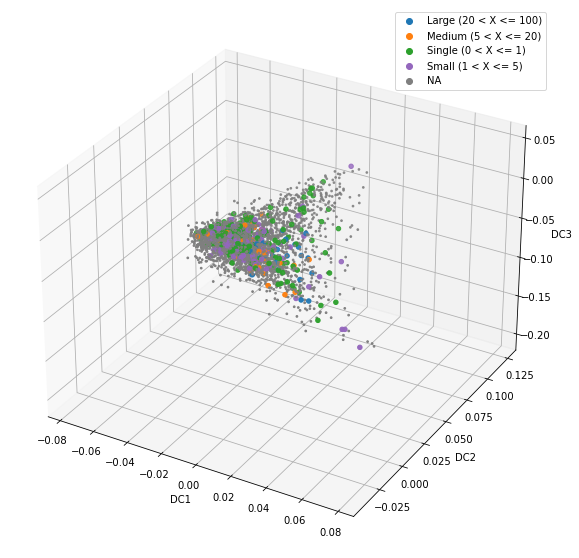

In [16]:
colors = {'Large (20 < X <= 100)':'tab:blue', 'Medium (5 < X <= 20)':'tab:orange', 'Single (0 < X <= 1)':'tab:green',
          'Small (1 < X <= 5)':'tab:purple', 'NA':'tab:grey'}

size = {'Large (20 < X <= 100)':20, 'Medium (5 < X <= 20)':20, 'Single (0 < X <= 1)':20,
          'Small (1 < X <= 5)':20, 'NA':3}
fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC2"], dm["DC3"], c = tcells.obs["cloneType"].map(colors), s= tcells.obs["cloneType"].map(size))
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')
ax.set_zlabel('DC3')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
plt.legend(markers, colors.keys(), numpoints=1)

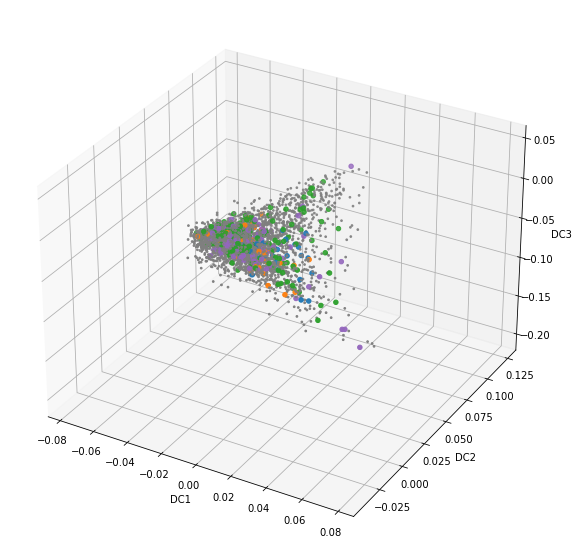

In [17]:
colors = {'Large (20 < X <= 100)':'tab:blue', 'Medium (5 < X <= 20)':'tab:orange', 'Single (0 < X <= 1)':'tab:green',
          'Small (1 < X <= 5)':'tab:purple', 'NA':'tab:grey'}

size = {'Large (20 < X <= 100)':20, 'Medium (5 < X <= 20)':20, 'Single (0 < X <= 1)':20,
          'Small (1 < X <= 5)':20, 'NA':3}
fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC2"], dm["DC3"], c = tcells.obs["cloneType"].map(colors), s= tcells.obs["cloneType"].map(size))
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')
ax.set_zlabel('DC3')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]


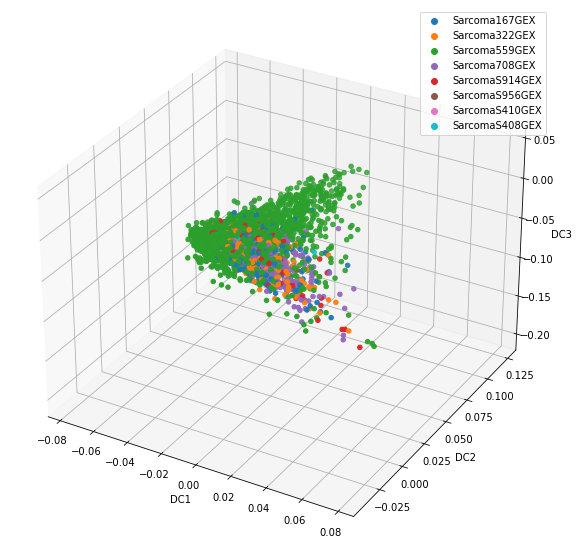

In [18]:
colors = {'Sarcoma167GEX':'tab:blue', 'Sarcoma322GEX':'tab:orange', 'Sarcoma559GEX':'tab:green',
          'Sarcoma708GEX':'tab:purple', 'SarcomaS914GEX':'tab:red', 'SarcomaS956GEX':'tab:brown', 
          'SarcomaS410GEX':'tab:pink',
          'SarcomaS408GEX':'tab:cyan'}


fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC2"], dm["DC3"], c = tcells.obs["orig.ident"].map(colors))
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')
ax.set_zlabel('DC3')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
plt.legend(markers, colors.keys(), numpoints=1)

plt.show()

In [19]:
set(tcells.obs['bi_assignments'])

{'Progenitor-like CD8+ T', 'Tex CD8+', 'Trm CD8+ T'}

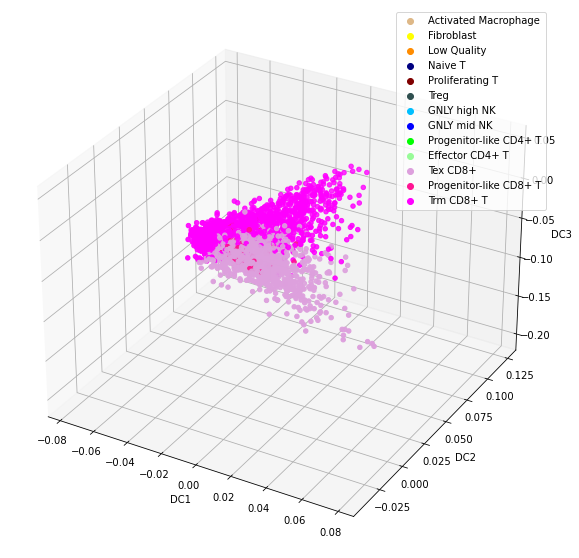

In [20]:
colors = {'Activated Macrophage':'#deb887',
 'Fibroblast':"#ffff00",
 'Low Quality':"#ff8c00",
 'Naive T':'#000080',
 'Proliferating T':'#800000',
 'Treg':'#2f4f4f',
 'GNLY high NK':'#00bfff',
 'GNLY mid NK':'#0000ff',
 'Progenitor-like CD4+ T':'#00ff00',
 'Effector CD4+ T': '#98fb98',
 'Tex CD8+':'#dda0dd',
 'Progenitor-like CD8+ T':'#ff1493',
 'Trm CD8+ T':'#ff00ff',
}




fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC2"], dm["DC3"], c = tcells.obs["bi_assignments"].map(colors))
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')
ax.set_zlabel('DC3')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
plt.legend(markers, colors.keys(), numpoints=1)

plt.show()

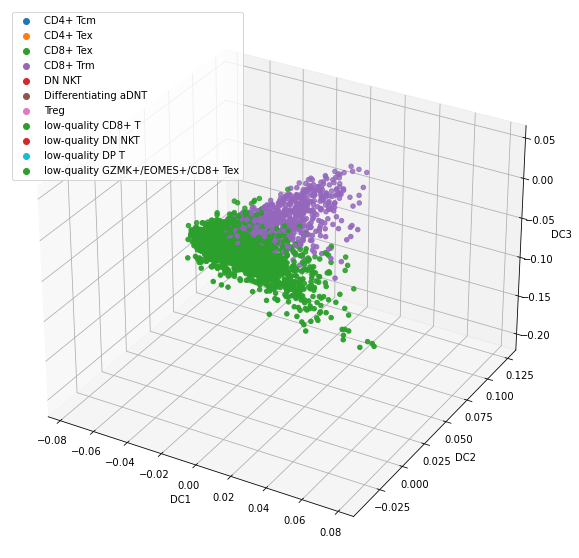

In [21]:
colors = {'CD4+ Tcm':'tab:blue', 'CD4+ Tex':'tab:orange', 'CD8+ Tex':'tab:green',
          'CD8+ Trm':'tab:purple', 'DN NKT':'tab:red', 'Differentiating aDNT':'tab:brown', 
          'Treg':'tab:pink',
          'low-quality CD8+ T':'tab:green',
         'low-quality DN NKT': 'tab:red',
         'low-quality DP T': 'tab:cyan',
         'low-quality GZMK+/EOMES+/CD8+ Tex' : 'tab:green'
         }


fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC2"], dm["DC3"], c = tcells.obs["k_assignments"].map(colors))
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')
ax.set_zlabel('DC3')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
plt.legend(markers, colors.keys(), numpoints=1)

plt.show()

In [22]:
cmap = plt.cm.get_cmap('viridis')
dm["size"]  = tcells.obs["TCF7"] > 0
dm["size"] = dm["size"].map({True: 20, False:5})
color =  cmap(tcells.obs["TCF7"])


In [23]:
tcells.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.rps,percent.rpl,percent.rp,patient,celltype_initial_singleR,predicted_doublets,...,alt_names,TOX,TCF7,cloneType,DC1,DC2,DC3,DC4,DC5,DC6
alt_names,,,,,,,,,,,,,,,,,,,,,
CTAAGACAGAAGGTGA-1_1,Sarcoma167GEX,2909,1608,1.271915,0.550017,0.446889,0.996906,Sarcoma167GEX,CD8+ T-cells,False,...,CTAAGACAGAAGGTGA-1_1,6.0,0.0,NA,0.007837,0.012169,0.015127,-0.004702,-0.006796,0.013763
CGAGCACGTATGCTTG-1_1,Sarcoma167GEX,2416,1497,0.869205,0.372517,0.082781,0.455298,Sarcoma167GEX,CD4+ T-cells,False,...,CGAGCACGTATGCTTG-1_1,11.0,0.0,NA,0.011612,-0.012467,-0.003509,-0.013035,0.006829,0.008003
TACGGTAGTGACCAAG-1_1,Sarcoma167GEX,2358,1433,0.975403,0.212044,0.042409,0.254453,Sarcoma167GEX,CD8+ T-cells,False,...,TACGGTAGTGACCAAG-1_1,5.0,0.0,NA,-0.014646,-0.003262,0.016182,-0.007007,-0.023731,0.000507
CTAATGGCAACACCTA-1_1,Sarcoma167GEX,2393,1593,1.671542,0.376097,0.208943,0.585040,Sarcoma167GEX,CD8+ T-cells,False,...,CTAATGGCAACACCTA-1_1,1.0,0.0,NA,-0.009463,0.005609,-0.005171,0.014116,0.002672,0.002520
AACTCTTTCTGCTGTC-1_1,Sarcoma167GEX,2244,1435,0.891266,0.178253,0.044563,0.222816,Sarcoma167GEX,CD8+ T-cells,False,...,AACTCTTTCTGCTGTC-1_1,3.0,0.0,NA,-0.009014,0.002084,0.007760,-0.000695,-0.000883,0.024630
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTTTCTAGTGCTAGCC-1_7,SarcomaS914GEX,846,652,4.846336,1.182033,1.773050,2.955083,SarcomaS914GEX,CD8+ T-cells,False,...,GTTTCTAGTGCTAGCC-1_7,1.0,0.0,Small (1 < X <= 5),-0.000118,0.006959,-0.002925,0.015080,0.014241,0.012981
CCATGTCAGAATGTGT-1_7,SarcomaS914GEX,672,544,5.208333,0.595238,1.339286,1.934524,SarcomaS914GEX,CD8+ T-cells,False,...,CCATGTCAGAATGTGT-1_7,0.0,0.0,NA,-0.008784,-0.005350,-0.007829,0.005529,0.009243,-0.002981
TACTTGTCACCACCAG-1_8,SarcomaS956GEX,2294,1325,0.130776,0.305144,0.043592,0.348736,SarcomaS956GEX,CD8+ T-cells,False,...,TACTTGTCACCACCAG-1_8,5.0,0.0,NA,0.000945,-0.000678,0.009486,-0.006063,-0.000545,0.009265


In [24]:
tcells.obs["TCF7"]

alt_names
CTAAGACAGAAGGTGA-1_1    0.0
CGAGCACGTATGCTTG-1_1    0.0
TACGGTAGTGACCAAG-1_1    0.0
CTAATGGCAACACCTA-1_1    0.0
AACTCTTTCTGCTGTC-1_1    0.0
                       ... 
GTTTCTAGTGCTAGCC-1_7    0.0
CCATGTCAGAATGTGT-1_7    0.0
TACTTGTCACCACCAG-1_8    0.0
CTAATGGTCCTCAACC-1_8    0.0
AACTTTCGTTATGTGC-1_8    1.0
Name: TCF7, Length: 4051, dtype: float64

In [25]:
 tcells.obs["TOX"]

alt_names
CTAAGACAGAAGGTGA-1_1     6.0
CGAGCACGTATGCTTG-1_1    11.0
TACGGTAGTGACCAAG-1_1     5.0
CTAATGGCAACACCTA-1_1     1.0
AACTCTTTCTGCTGTC-1_1     3.0
                        ... 
GTTTCTAGTGCTAGCC-1_7     1.0
CCATGTCAGAATGTGT-1_7     0.0
TACTTGTCACCACCAG-1_8     5.0
CTAATGGTCCTCAACC-1_8     1.0
AACTTTCGTTATGTGC-1_8     4.0
Name: TOX, Length: 4051, dtype: float64

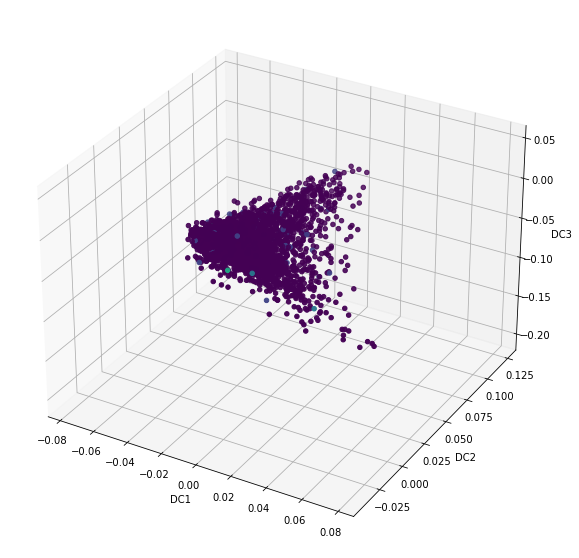

In [26]:
fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot(projection='3d')


ax.scatter(dm["DC1"], dm["DC2"], dm["DC3"], c = tcells.obs["TCF7"], cmap= cmap)
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')
ax.set_zlabel('DC3')


plt.show()

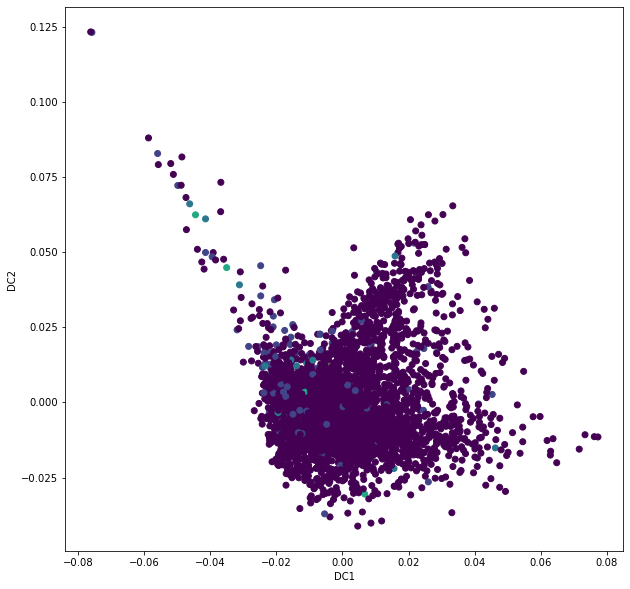

In [27]:
fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot()


ax.scatter(dm["DC1"], dm["DC2"], c = tcells.obs["TCF7"], cmap= cmap)
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')


plt.show()

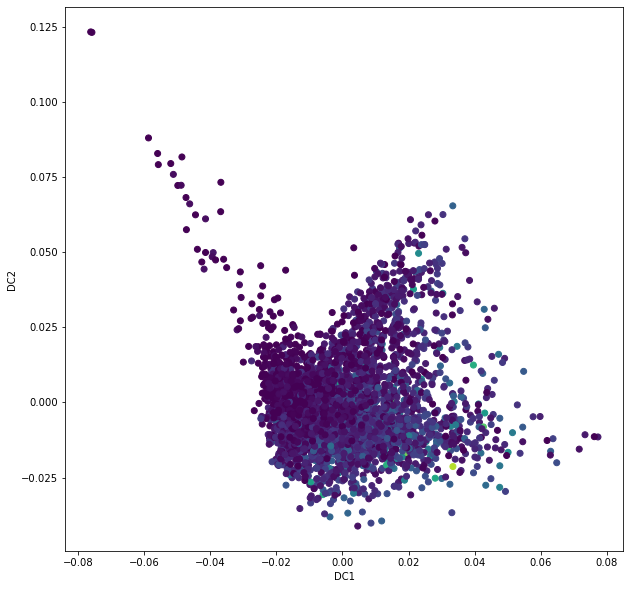

In [28]:

fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot()
ax.scatter(dm["DC1"], dm["DC2"], c = tcells.obs["TOX"], cmap= cmap)
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')


plt.show()

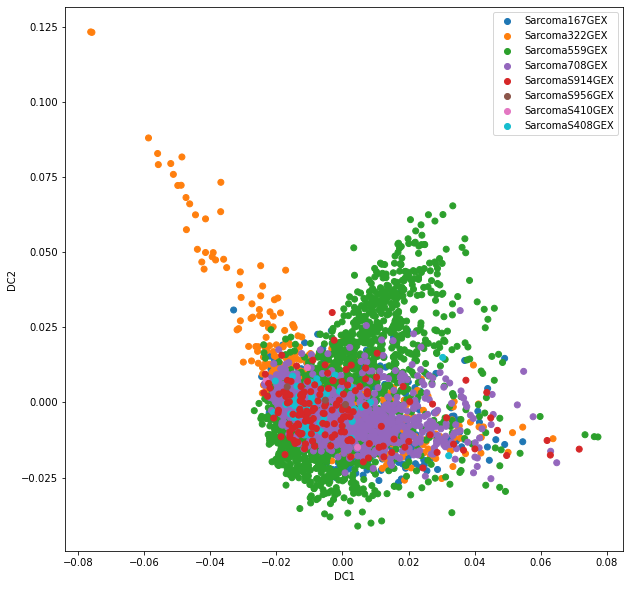

In [29]:
colors = {'Sarcoma167GEX':'tab:blue', 'Sarcoma322GEX':'tab:orange', 'Sarcoma559GEX':'tab:green',
          'Sarcoma708GEX':'tab:purple', 'SarcomaS914GEX':'tab:red', 'SarcomaS956GEX':'tab:brown', 
          'SarcomaS410GEX':'tab:pink',
          'SarcomaS408GEX':'tab:cyan'}


fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot()

ax.scatter(dm["DC1"], dm["DC2"], c = tcells.obs["orig.ident"].map(colors))
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
plt.legend(markers, colors.keys(), numpoints=1)

plt.show()

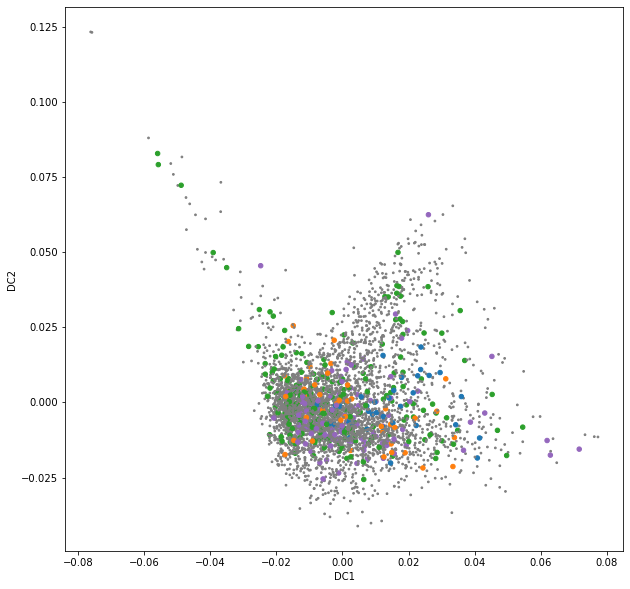

In [30]:
colors = {'Large (20 < X <= 100)':'tab:blue', 'Medium (5 < X <= 20)':'tab:orange', 'Single (0 < X <= 1)':'tab:green',
          'Small (1 < X <= 5)':'tab:purple', 'NA':'tab:grey'}

size = {'Large (20 < X <= 100)':20, 'Medium (5 < X <= 20)':20, 'Single (0 < X <= 1)':20,
          'Small (1 < X <= 5)':20, 'NA':3}
fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot()

ax.scatter(dm["DC1"], dm["DC2"], c = tcells.obs["cloneType"].map(colors), s= tcells.obs["cloneType"].map(size))
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]


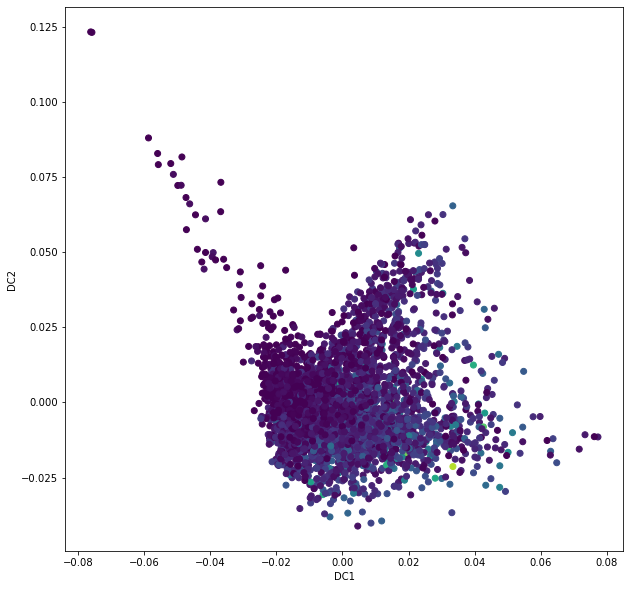

In [31]:

fig = plt.figure( figsize=(10, 10))
ax = fig.add_subplot()
ax.scatter(dm["DC1"], dm["DC2"], c = tcells.obs["TOX"], cmap= cmap)
ax.set_xlabel('DC1')
ax.set_ylabel('DC2')


plt.show()

In [32]:
myeloid = sc.read_h5ad("DiffusionAnalysisData/BI_Myeloid_DM_obj.h5ad")
myeloid_meta = pd.read_csv("DiffusionAnalysisData/BI_Myeloid_DM_obj.csv").set_index("Unnamed: 0")
myeloid.obs = myeloid_meta
dm_myeloid = pd.read_csv("DiffusionAnalysisData/Integrated_BI_Myeloid_DM_V2_obj_25_eigenvectors.csv").set_index("Unnamed: 0")


In [33]:
myeloid = myeloid[myeloid.obs.index.isin(dm_myeloid.index)]


In [34]:
set(myeloid.obs["assignments_bi_mye"])

{'Activated Monocyte',
 'Differentiating Monocytes',
 'Granulocytes',
 'M1-like Macrophages',
 'M2-like Macrophages',
 'Proliferating Myeloid Cells',
 'SPP1+ Macrophages'}

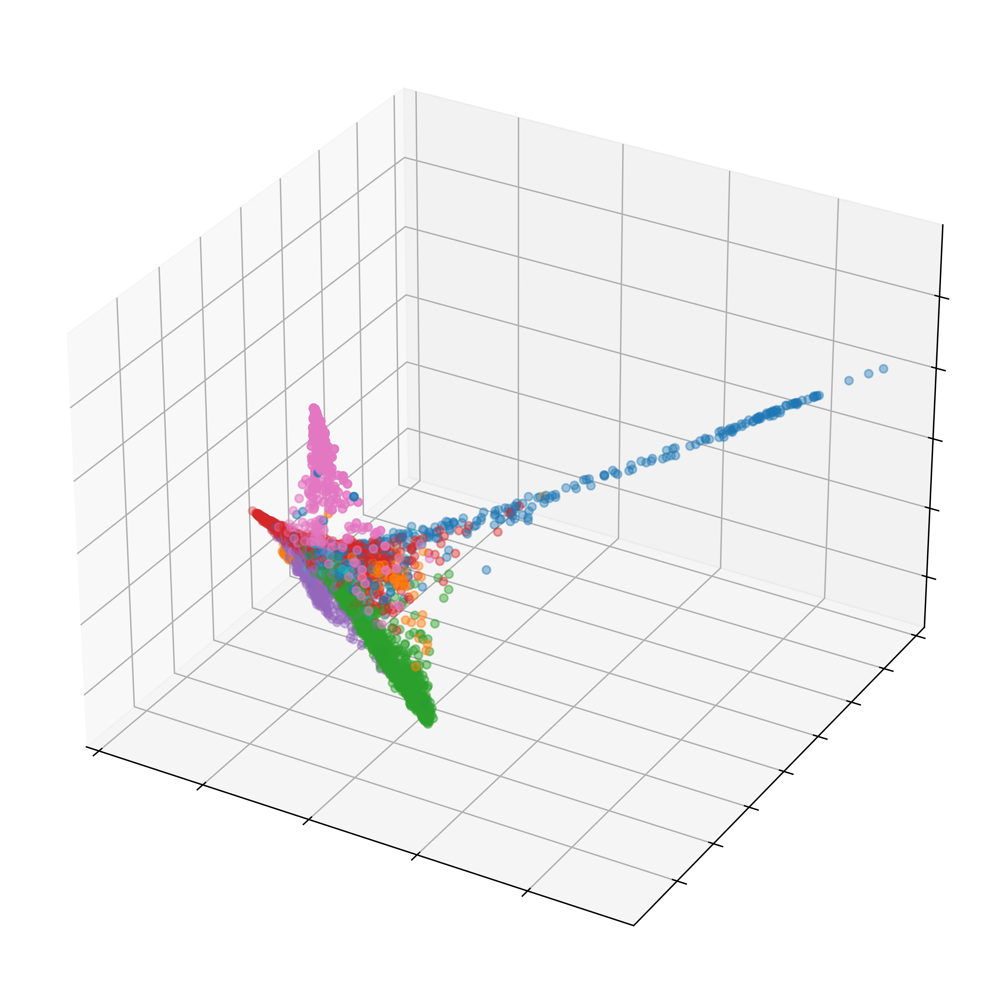

In [94]:
fig = plt.figure( figsize=(10, 10), dpi = 800)
ax = fig.add_subplot(projection='3d')

colors = {'Activated Monocyte':'tab:blue', 
          'Differentiating Monocytes':'tab:orange',
          'Granulocytes':'tab:green',
          'M1-like Macrophages':'tab:purple',
          'M2-like Macrophages':'tab:red', 
          'Non-Classical Monocytes':'tab:brown', 
          'Proliferating Myeloid Cells':'tab:pink',
          'SPP1+ Macrophages': 'tab:cyan',
         }
ax.scatter(dm_myeloid["DC1"], dm_myeloid["DC2"], dm_myeloid["DC3"], c = myeloid.obs["assignments_bi_mye"].map(colors))
#ax.set_xlabel('DC1')
#ax.set_ylabel('DC2')
#ax.set_zlabel('DC3')

ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
#plt.legend(markers, colors.keys(), numpoints=1)

plt.show()



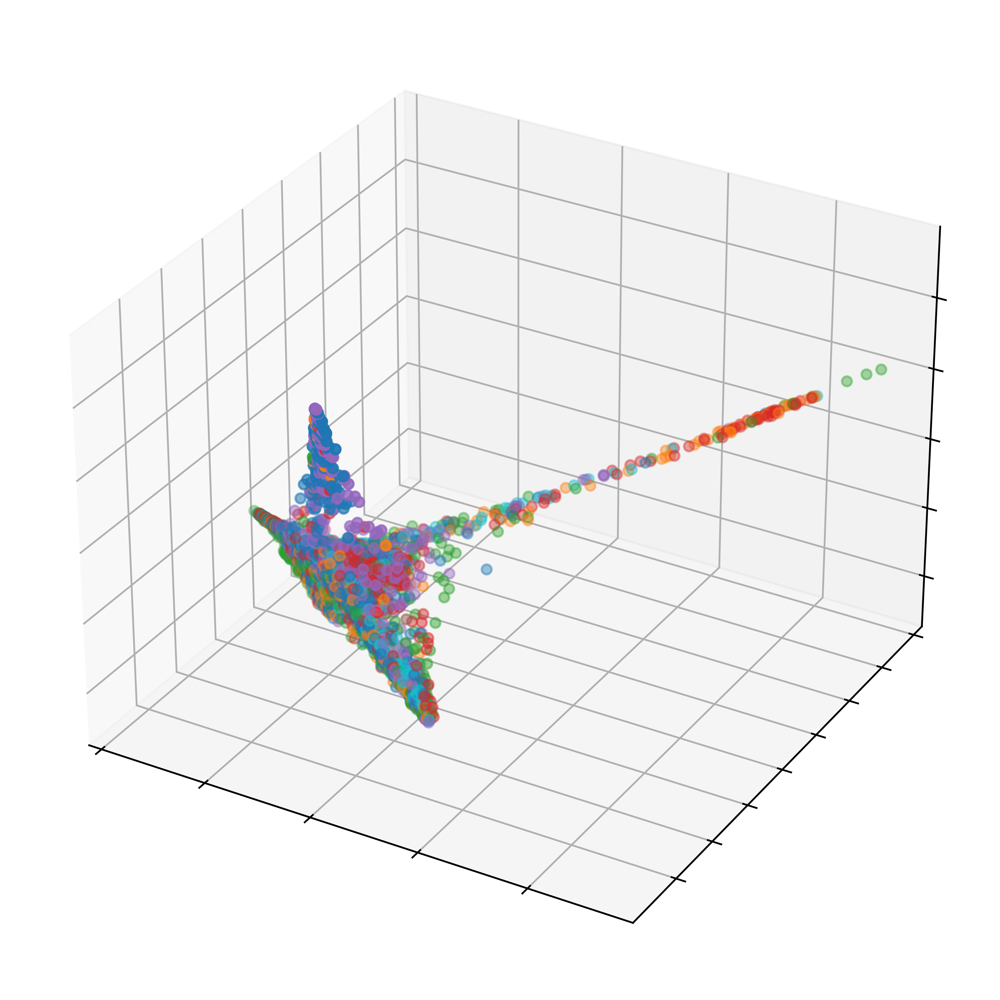

In [93]:
fig = plt.figure( figsize=(8, 8), dpi = 800)
ax = fig.add_subplot(projection='3d')
colors = {'Sarcoma167GEX':'tab:blue', 'Sarcoma322GEX':'tab:orange', 'Sarcoma559GEX':'tab:green',
          'Sarcoma708GEX':'tab:purple', 'SarcomaS914GEX':'tab:red', 'SarcomaS956GEX':'tab:brown', 
          'SarcomaS410GEX':'tab:pink',
          'SarcomaS408GEX':'tab:cyan'}
ax.scatter(dm_myeloid["DC1"], dm_myeloid["DC2"], dm_myeloid["DC3"], c = myeloid.obs["orig.ident"].map(colors))
#ax.set_xlabel('DC1')
#ax.set_ylabel('DC2')
#ax.set_zlabel('DC3')

ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
#plt.legend(markers, colors.keys(), numpoints=1)

plt.show()

In [37]:
myeloid.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.rps,percent.rpl,percent.rp,patient,celltype_initial_singleR,predicted_doublets,...,integrated_snn_res.0.8,celltype_bped_fine,integrated_snn_res.0.2,BI_broad_assignments,BI_specific_assignments,BI_broad_assignments_v2,integrated_snn_res.0.5,subclusters,assignments_k_mye,assignments_bi_mye
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
AGGGTGACATTAGCCA-1_1,Sarcoma167GEX,9593,4041,5.608256,0.198061,0.093818,0.291879,Sarcoma167GEX,CD8+ T-cells,False,...,18,Monocytes,10,Myeloid,proliferating monoctye,Myeloid,9,9,Poliferating Macrophages,Proliferating Myeloid Cells
TGGCCAGTCATGCTCC-1_1,Sarcoma167GEX,8538,3316,1.112673,0.152260,0.000000,0.152260,Sarcoma167GEX,Macrophages,False,...,0,Macrophages,0,Myeloid,macrophage,Myeloid,6,6,Macrophages,SPP1+ Macrophages
CCTAAAGGTTCACCTC-1_1,Sarcoma167GEX,7539,3089,6.194455,0.132644,0.013264,0.145908,Sarcoma167GEX,Macrophages,False,...,18,Monocytes,10,Myeloid,proliferating monoctye,Myeloid,9,9,Poliferating Macrophages,Proliferating Myeloid Cells
CGGAGTCTCCAAACTG-1_1,Sarcoma167GEX,7366,3227,2.402932,0.135759,0.081455,0.217214,Sarcoma167GEX,Macrophages,False,...,18,Monocytes,0,Myeloid,macrophage,Myeloid,5,5,Monocytes,Activated Monocyte
AGCGTATAGGCCGAAT-1_1,Sarcoma167GEX,6524,2830,1.594114,0.168608,0.061312,0.229920,Sarcoma167GEX,Macrophages,False,...,3,Macrophages,0,Myeloid,macrophage,Myeloid,3,3,Macrophages,M1-like Macrophages
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CATTCGCGTACTCAAC-1_8,SarcomaS956GEX,1453,1001,0.412939,0.412939,0.000000,0.412939,SarcomaS956GEX,Monocytes,False,...,20,Monocytes,5,Myeloid,monocyte,Myeloid,8,8,Macrophages,Differentiating Monocytes
GTGGGTCAGGCTAGGT-1_8,SarcomaS956GEX,1439,926,0.347464,0.069493,0.000000,0.069493,SarcomaS956GEX,Monocytes,False,...,10,Monocytes,5,Myeloid,monocyte,Myeloid,4,4,Macrophages,Granulocytes
CTGTGCTCACAAGCCC-1_8,SarcomaS956GEX,1484,889,1.819407,0.269542,0.067385,0.336927,SarcomaS956GEX,Monocytes,False,...,3,Macrophages,0,Myeloid,macrophage,Myeloid,3,3,Macrophages,M1-like Macrophages


In [38]:
from collections import Counter
Counter(tcells.obs["TOX"]).most_common()

[(0.0, 420),
 (1.0, 288),
 (5.0, 283),
 (2.0, 274),
 (3.0, 265),
 (4.0, 252),
 (7.0, 231),
 (6.0, 217),
 (8.0, 205),
 (9.0, 176),
 (10.0, 149),
 (11.0, 140),
 (13.0, 123),
 (14.0, 102),
 (12.0, 99),
 (16.0, 93),
 (15.0, 88),
 (17.0, 82),
 (19.0, 65),
 (18.0, 62),
 (20.0, 46),
 (21.0, 43),
 (22.0, 42),
 (24.0, 37),
 (23.0, 30),
 (25.0, 29),
 (26.0, 25),
 (27.0, 23),
 (29.0, 16),
 (28.0, 14),
 (31.0, 11),
 (37.0, 11),
 (40.0, 10),
 (32.0, 10),
 (30.0, 9),
 (33.0, 9),
 (36.0, 9),
 (39.0, 7),
 (35.0, 6),
 (38.0, 5),
 (44.0, 4),
 (34.0, 4),
 (41.0, 3),
 (54.0, 3),
 (42.0, 3),
 (43.0, 3),
 (55.0, 3),
 (45.0, 2),
 (56.0, 2),
 (46.0, 2),
 (57.0, 2),
 (49.0, 2),
 (81.0, 1),
 (62.0, 1),
 (90.0, 1),
 (71.0, 1),
 (66.0, 1),
 (65.0, 1),
 (80.0, 1),
 (61.0, 1),
 (52.0, 1),
 (72.0, 1),
 (51.0, 1),
 (47.0, 1)]

In [39]:
tcells.obs['TOX_2'] = tcells.obs['TOX'].rank(pct=True)
tcells.obs.loc[tcells.obs['TOX'] <= 0, 'TOX_2'] = 0

In [40]:
tcells.obs['TCF7_2'] = tcells.obs['TCF7'].rank(pct=True)
tcells.obs.loc[tcells.obs['TCF7'] <= 0, 'TCF7_2'] = 0



In [41]:
tcells.obs["Assignment"] = "NA"

tcells.obs.loc[tcells.obs['TCF7_2'] > 0.9, 'Assignment'] = 'TCF7+'
tcells.obs.loc[tcells.obs['TOX_2'] > 0.9, 'Assignment' ] = 'TOX+'


In [42]:
from collections import Counter
Counter(tcells.obs['Assignment'])

Counter({'NA': 3462, 'TCF7+': 198, 'TOX+': 391})

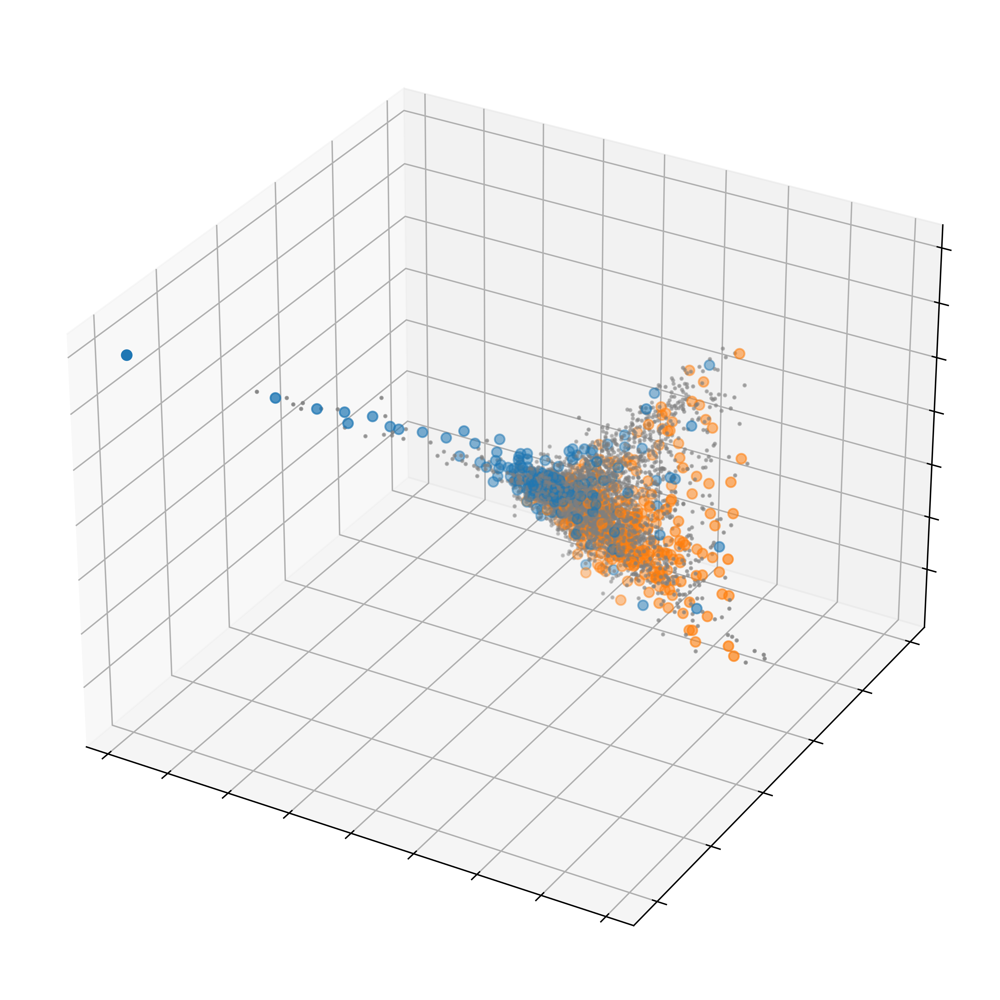

In [90]:
colors = {'TCF7+':'tab:blue', 'TOX+':'tab:orange', 'NA':'tab:grey'}

size = {'TCF7+':30, 'TOX+':30, 'NA':2}

fig = plt.figure(figsize=(10, 10), 
           dpi = 800)
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC3"], dm["DC2"], c = tcells.obs["Assignment"].map(colors), s= tcells.obs["Assignment"].map(size))
#ax.set_xlabel('DC1')
#ax.set_ylabel('DC3')
#ax.set_zlabel('DC2')

ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
#plt.legend(markers, colors.keys(), numpoints=1)

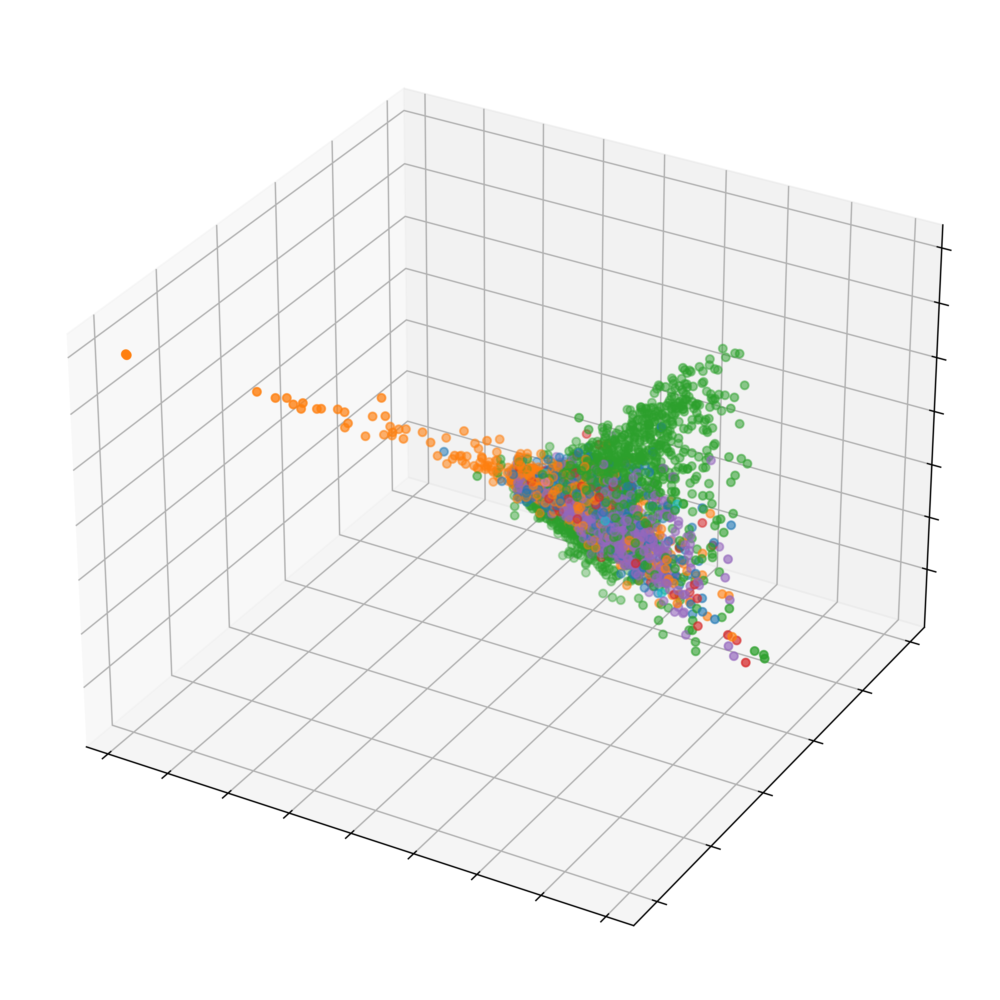

In [91]:
colors = {'Sarcoma167GEX':'tab:blue', 'Sarcoma322GEX':'tab:orange', 'Sarcoma559GEX':'tab:green',
          'Sarcoma708GEX':'tab:purple', 'SarcomaS914GEX':'tab:red', 'SarcomaS956GEX':'tab:brown', 
          'SarcomaS410GEX':'tab:pink',
          'SarcomaS408GEX':'tab:cyan'}


fig = plt.figure(figsize=(10, 10), 
           dpi = 800)
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC3"], dm["DC2"], c = tcells.obs["orig.ident"].map(colors))
#ax.set_xlabel('DC1')
#ax.set_ylabel('DC3')
#ax.set_zlabel('DC2')
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
#plt.legend(markers, colors.keys(), numpoints=1)

plt.show()

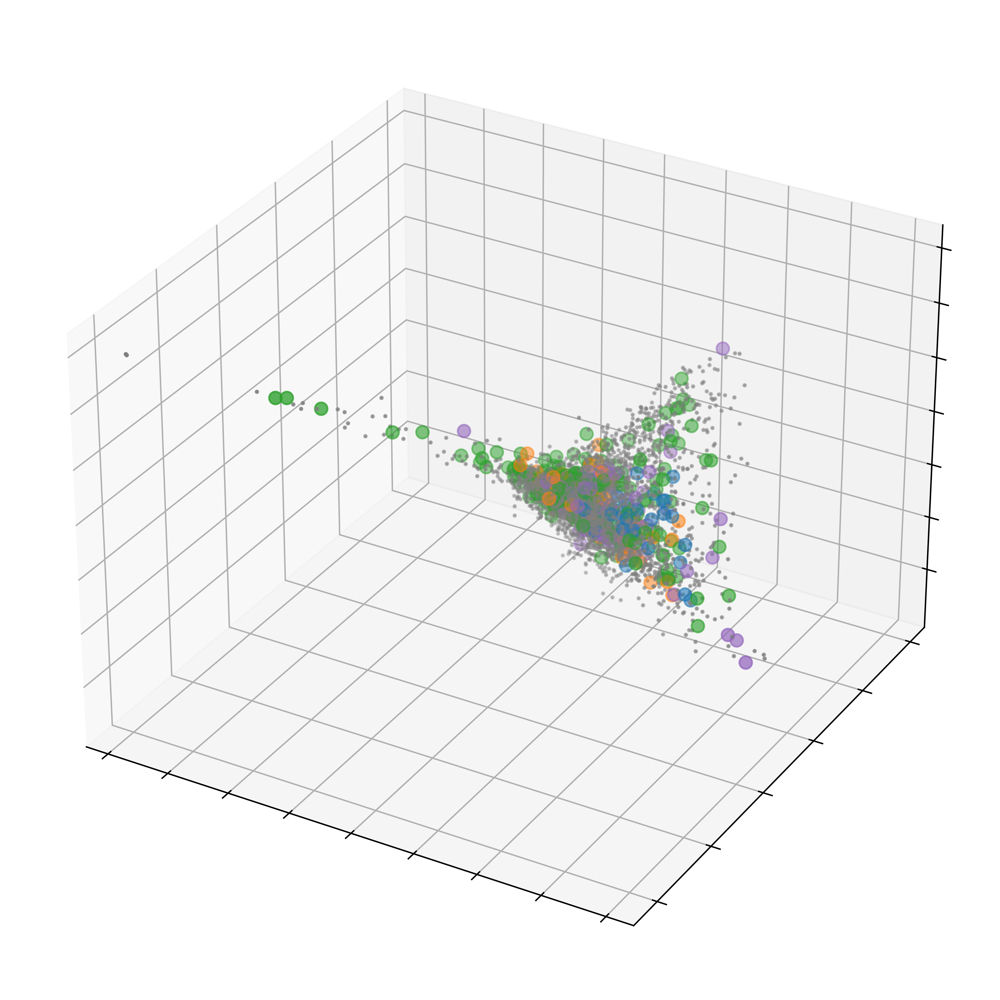

In [92]:
dm["cloneType"] = tcells.obs["cloneType"]
colors = {'Large (20 < X <= 100)':'tab:blue', 'Medium (5 < X <= 20)':'tab:orange', 'Single (0 < X <= 1)':'tab:green',
          'Small (1 < X <= 5)':'tab:purple', 'NA':'tab:grey'}

size = {'Large (20 < X <= 100)':50, 'Medium (5 < X <= 20)':50, 'Single (0 < X <= 1)':50,
          'Small (1 < X <= 5)':50, 'NA':2}

alphas = {'Large (20 < X <= 100)':1, 'Medium (5 < X <= 20)':1, 'Single (0 < X <= 1)':1,
          'Small (1 < X <= 5)':1, 'NA':0.25}
zorder_values = dm["cloneType"].map(colors).apply(lambda color: 2 if color != 'tab:grey' else 1)


fig = plt.figure( figsize=(10, 10), 
           dpi = 800)
ax = fig.add_subplot(projection='3d')



ax.scatter(dm["DC1"], dm["DC3"], dm["DC2"], 
           c = dm["cloneType"].map(colors), s= dm["cloneType"].map(size), zorder=zorder_values)
#ax.set_xlabel('DC1')
#ax.set_ylabel('DC3')
#ax.set_zlabel('DC2')
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])

plt.show()

In [81]:
zorder_values

Unnamed: 0
CTAAGACAGAAGGTGA-1_1    1
CGAGCACGTATGCTTG-1_1    1
TACGGTAGTGACCAAG-1_1    1
CTAATGGCAACACCTA-1_1    1
AACTCTTTCTGCTGTC-1_1    1
                       ..
GTTTCTAGTGCTAGCC-1_7    2
CCATGTCAGAATGTGT-1_7    1
TACTTGTCACCACCAG-1_8    1
CTAATGGTCCTCAACC-1_8    1
AACTTTCGTTATGTGC-1_8    1
Name: cloneType, Length: 4051, dtype: int64

In [63]:
dm[dm["cloneType"].map(colors) != 'tab:grey'].index

Index(['AGTGGGACATCTCGCT-1_1', 'ATAACGCGTCTGGAGA-1_1', 'CCTTTCTTCACGGTTA-1_1',
       'AACTCTTCAGACACTT-1_1', 'GGCTCGAAGTTCGCAT-1_1', 'GTGTTAGGTCAGATAA-1_1',
       'TATCTCATCGCCGTGA-1_1', 'ATCATCTGTGATGTCT-1_1', 'ATTATCCCAGTTAACC-1_1',
       'AGAATAGGTGACAAAT-1_1',
       ...
       'CCTACCAAGATCTGAA-1_7', 'GACAGAGTCGTTACGA-1_7', 'GTATTCTTCCCACTTG-1_7',
       'AGATTGCGTCCATGAT-1_7', 'CATATTCTCAGCTTAG-1_7', 'TGCACCTCATCCGGGT-1_7',
       'CGGCTAGGTTATGTGC-1_7', 'TCATTACGTTTGCATG-1_7', 'GGAACTTTCTGCGGCA-1_7',
       'GTTTCTAGTGCTAGCC-1_7'],
      dtype='object', name='Unnamed: 0', length=446)

In [83]:
dm[zorder_values != 1.0].index

Index(['AGTGGGACATCTCGCT-1_1', 'ATAACGCGTCTGGAGA-1_1', 'CCTTTCTTCACGGTTA-1_1',
       'AACTCTTCAGACACTT-1_1', 'GGCTCGAAGTTCGCAT-1_1', 'GTGTTAGGTCAGATAA-1_1',
       'TATCTCATCGCCGTGA-1_1', 'ATCATCTGTGATGTCT-1_1', 'ATTATCCCAGTTAACC-1_1',
       'AGAATAGGTGACAAAT-1_1',
       ...
       'CCTACCAAGATCTGAA-1_7', 'GACAGAGTCGTTACGA-1_7', 'GTATTCTTCCCACTTG-1_7',
       'AGATTGCGTCCATGAT-1_7', 'CATATTCTCAGCTTAG-1_7', 'TGCACCTCATCCGGGT-1_7',
       'CGGCTAGGTTATGTGC-1_7', 'TCATTACGTTTGCATG-1_7', 'GGAACTTTCTGCGGCA-1_7',
       'GTTTCTAGTGCTAGCC-1_7'],
      dtype='object', name='Unnamed: 0', length=446)

In [ ]:
tcells.obs["cloneType"].map(colors)

alt_names
CTAAGACAGAAGGTGA-1_1      tab:grey
CGAGCACGTATGCTTG-1_1      tab:grey
TACGGTAGTGACCAAG-1_1      tab:grey
CTAATGGCAACACCTA-1_1      tab:grey
AACTCTTTCTGCTGTC-1_1      tab:grey
                           ...    
GTTTCTAGTGCTAGCC-1_7    tab:purple
CCATGTCAGAATGTGT-1_7      tab:grey
TACTTGTCACCACCAG-1_8      tab:grey
CTAATGGTCCTCAACC-1_8      tab:grey
AACTTTCGTTATGTGC-1_8      tab:grey
Name: cloneType, Length: 4051, dtype: object

In [54]:
tcells.obs["cloneType"].map(alphas)

alt_names
CTAAGACAGAAGGTGA-1_1    0.25
CGAGCACGTATGCTTG-1_1    0.25
TACGGTAGTGACCAAG-1_1    0.25
CTAATGGCAACACCTA-1_1    0.25
AACTCTTTCTGCTGTC-1_1    0.25
                        ... 
GTTTCTAGTGCTAGCC-1_7    1.00
CCATGTCAGAATGTGT-1_7    0.25
TACTTGTCACCACCAG-1_8    0.25
CTAATGGTCCTCAACC-1_8    0.25
AACTTTCGTTATGTGC-1_8    0.25
Name: cloneType, Length: 4051, dtype: float64

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,percent.rps,percent.rpl,percent.rp,patient,celltype_initial_singleR,predicted_doublets,...,cloneType,DC1,DC2,DC3,DC4,DC5,DC6,TOX_2,TCF7_2,Assignment
alt_names,,,,,,,,,,,,,,,,,,,,,
CTAAGACAGAAGGTGA-1_1,Sarcoma167GEX,2909,1608,1.271915,0.550017,0.446889,0.996906,Sarcoma167GEX,CD8+ T-cells,False,...,NA,0.007837,0.012169,0.015127,-0.004702,-0.006796,0.013763,0.466798,0.000000,NA
CGAGCACGTATGCTTG-1_1,Sarcoma167GEX,2416,1497,0.869205,0.372517,0.082781,0.455298,Sarcoma167GEX,CD4+ T-cells,False,...,NA,0.011612,-0.012467,-0.003509,-0.013035,0.006829,0.008003,0.698716,0.000000,NA
TACGGTAGTGACCAAG-1_1,Sarcoma167GEX,2358,1433,0.975403,0.212044,0.042409,0.254453,Sarcoma167GEX,CD8+ T-cells,False,...,NA,-0.014646,-0.003262,0.016182,-0.007007,-0.023731,0.000507,0.405085,0.000000,NA
CTAATGGCAACACCTA-1_1,Sarcoma167GEX,2393,1593,1.671542,0.376097,0.208943,0.585040,Sarcoma167GEX,CD8+ T-cells,False,...,NA,-0.009463,0.005609,-0.005171,0.014116,0.002672,0.002520,0.139348,0.000000,NA
AACTCTTTCTGCTGTC-1_1,Sarcoma167GEX,2244,1435,0.891266,0.178253,0.044563,0.222816,Sarcoma167GEX,CD8+ T-cells,False,...,NA,-0.009014,0.002084,0.007760,-0.000695,-0.000883,0.024630,0.275241,0.000000,NA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTTTCTAGTGCTAGCC-1_7,SarcomaS914GEX,846,652,4.846336,1.182033,1.773050,2.955083,SarcomaS914GEX,CD8+ T-cells,False,...,Small (1 < X <= 5),-0.000118,0.006959,-0.002925,0.015080,0.014241,0.012981,0.139348,0.000000,NA
CCATGTCAGAATGTGT-1_7,SarcomaS914GEX,672,544,5.208333,0.595238,1.339286,1.934524,SarcomaS914GEX,CD8+ T-cells,False,...,NA,-0.008784,-0.005350,-0.007829,0.005529,0.009243,-0.002981,0.000000,0.000000,NA
TACTTGTCACCACCAG-1_8,SarcomaS956GEX,2294,1325,0.130776,0.305144,0.043592,0.348736,SarcomaS956GEX,CD8+ T-cells,False,...,NA,0.000945,-0.000678,0.009486,-0.006063,-0.000545,0.009265,0.405085,0.000000,NA


In [46]:
tcells.obs['bi_assignments'] = tcells.obs['bi_assignments'].replace('Tex CD8+', 'TD CD8+')


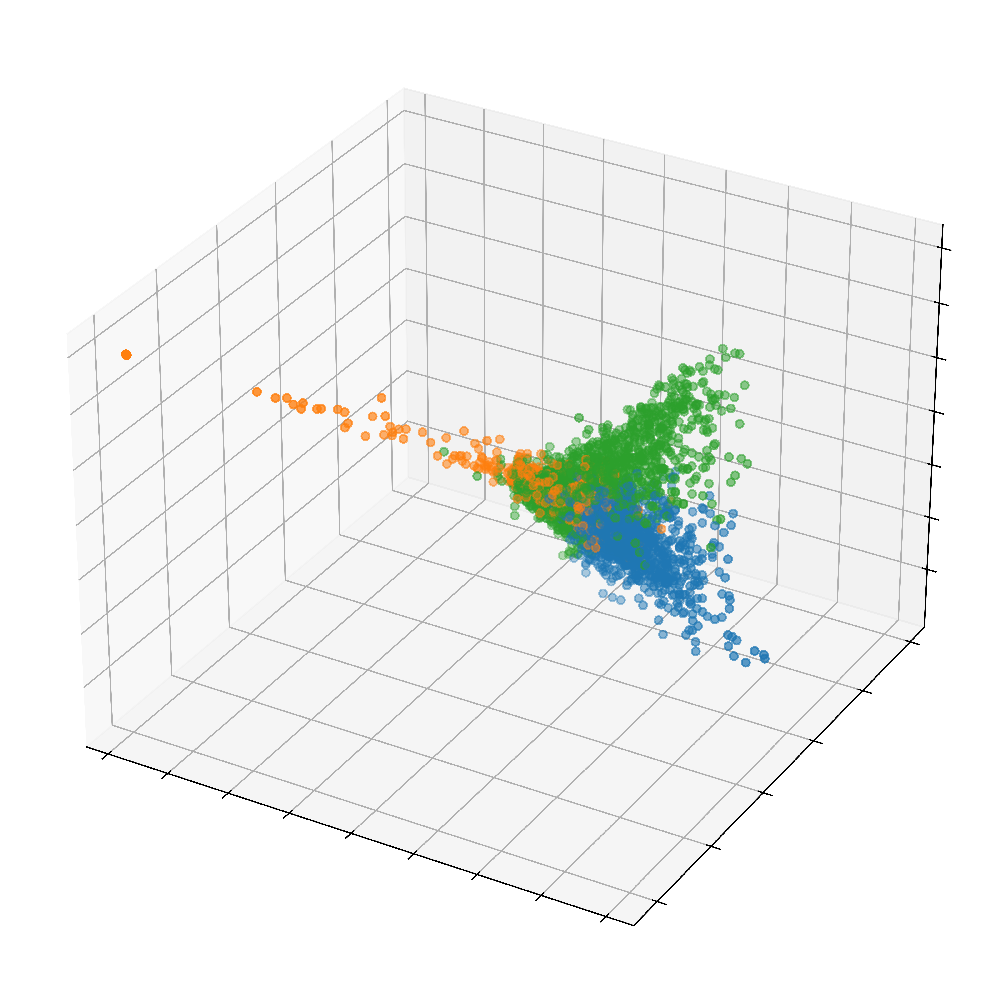

In [95]:
colors = {
 'TD CD8+':'tab:blue',

 'Progenitor-like CD8+ T':'tab:orange',
 'Trm CD8+ T':'tab:green',
}




fig = plt.figure( figsize=(10, 10), dpi = 800)
ax = fig.add_subplot(projection='3d')

ax.scatter(dm["DC1"], dm["DC3"], dm["DC2"], c = tcells.obs["bi_assignments"].map(colors))
#ax.set_xlabel('DC1')
#ax.set_ylabel('DC3')
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
#ax.set_zlabel('DC2')

markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in colors.values()]
#plt.legend(markers, colors.keys(), numpoints=1)

plt.show()

In [48]:
set(tcells.obs['bi_assignments'])

{'Progenitor-like CD8+ T', 'TD CD8+', 'Trm CD8+ T'}

(array([3840.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
         211.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

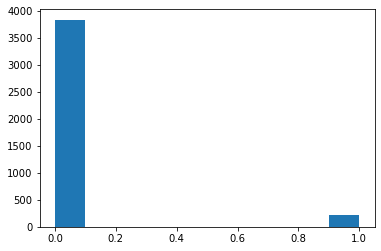

In [49]:
plt.hist(tcells.obs['TCF7_2'], bins=10)


(array([420., 288., 539., 252., 500., 436., 465., 324., 436., 391.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

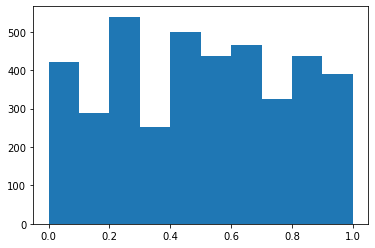

In [50]:
plt.hist(tcells.obs['TOX_2'], bins=10)
